# Block Iteration for Restoration of Astronomical Images

In [1]:
using LinearAlgebra, SparseArrays

block_size = 10   
gamma = 1e-3     
max_iters = 10       
tol = 1e-5  

n=100
b = rand(100, 100)       # blur image
H = sparse(rand(10000, 10000))  # PSF mat
Q = spdiagm(0 => ones(10000))  # constraint mat (laplacian?)

x = copy(vec(b))

nblocks = size(b,1) ÷ block_size
blocks = [(i, j) for i in 1:nblocks, j in 1:nblocks]

for iter = 1:max_iters
    x_old = copy(x)
    
    for (bi, bj) in blocks
        row_range = ((bi-1)*block_size + 1):(bi*block_size)
        col_range = ((bj-1)*block_size + 1):(bj*block_size)
        block_idx = vec([(i-1)*size(b,1) + j for i in row_range, j in col_range])
        
        # Extract submatrices/vectors
        Hii = H[block_idx, block_idx]
        bi_block = x_old[block_idx]  # Initial guess from previous iteration
        
        # Compute BMOD_i
        BMOD_i = b[row_range, col_range]
        BMOD_i = vec(BMOD_i)
        
        # Solve (HᵀH + γQᵀQ) x = Hᵀ b
        A = Hii' * Hii + gamma * (Q[block_idx, block_idx]' * Q[block_idx, block_idx])
        rhs = Hii' * BMOD_i
        
        x_block = A \ rhs
        
        # Update solution
        x[block_idx] = x_block
    end
    
    # Convergence check
    if norm(x - x_old) < tol
        println("Converged at iteration ", iter)
        break
    end
end

# --- Postprocessing ---
# Reshape x back into image form
restored_image = reshape(x, size(b));

Converged at iteration 2


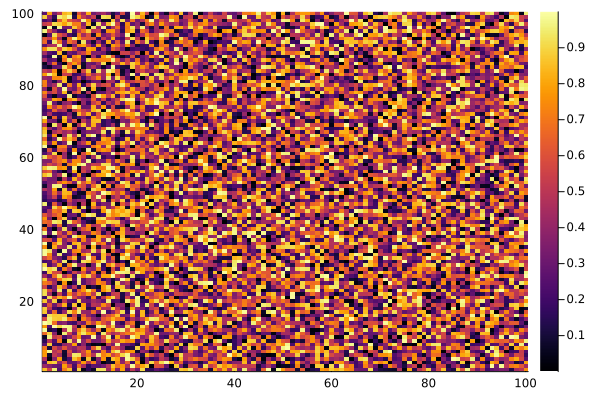

In [2]:
using Plots
heatmap(b)

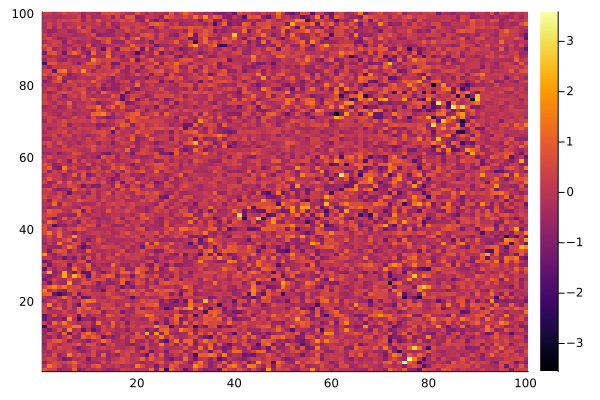

In [3]:
heatmap(restored_image)

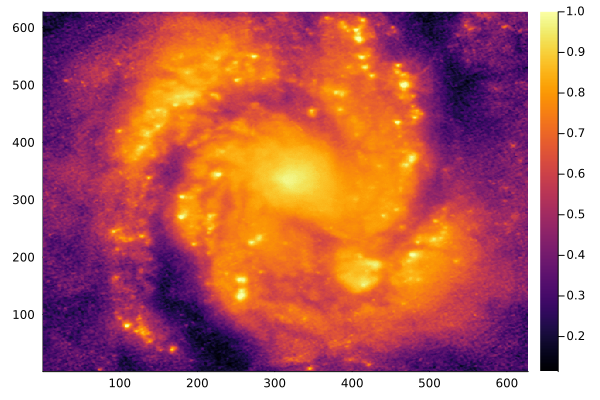

In [4]:
using Images, ImageIO

filepath = "m100-wfpc1.tif"
img = load(filepath)  # Load blurred image
gray_img = channelview(img)[1,:,:]     # Extract grayscale channel
b = Array(gray_img)                    # Convert to regular matrix

# import Pkg; Pkg.add("Plots")
using Plots

b = b ./ maximum(b)
b_flat = vec(b)
blimp = b
heatmap(b)

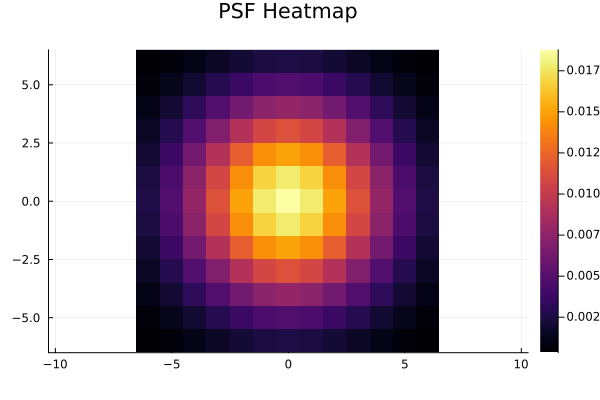

In [5]:
using ImageFiltering, Plots

sigma = 3.0
psf = Kernel.gaussian((sigma, sigma))

psf_array = psf

x = collect(axes(psf_array, 1))  # -4:4
y = collect(axes(psf_array, 2))  # -4:4

heatmap(x, y, psf_array,title="PSF Heatmap", colorbar=true, aspect_ratio=:equal)

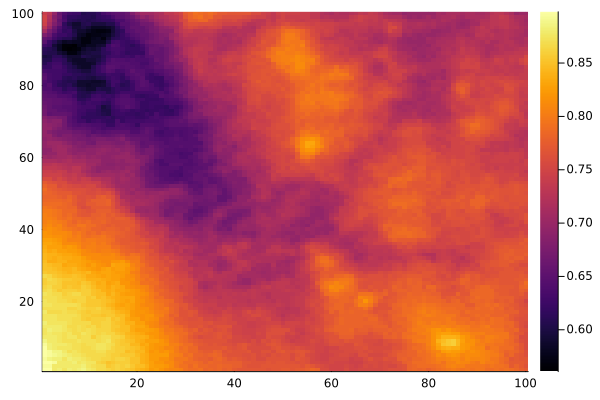

In [6]:
n=100

kx = 350
ky = 350

b = Array(gray_img[1+ky:n+ky, 1+kx:n+kx])
# img_size = size(b)
# n = img_size[1]

heatmap(b)

In [7]:
#testing on image
using LinearAlgebra, SparseArrays

block_size = Int(n / 10)
gamma = 1e-3     
max_iters = 5       
tol = 1e-5  

# n = 100
# b = rand(n, n)       # blur image
H = sparse(rand((n^2), (n^2)))  # random PSF
# H = psf
Q = spdiagm(0 => ones(n^2))  # constraint mat (laplacian?)

x = copy(vec(b))

nblocks = size(b,1) ÷ block_size
blocks = [(i, j) for i in 1:nblocks, j in 1:nblocks]

for iter = 1:max_iters
    x_old = copy(x)
    
    for (bi, bj) in blocks
        row_range = ((bi-1)*block_size + 1):(bi*block_size)
        col_range = ((bj-1)*block_size + 1):(bj*block_size)
        block_idx = vec([(i-1)*size(b,1) + j for i in row_range, j in col_range])
        
        # Extract submatrices/vectors
        Hii = H[block_idx, block_idx]
        bi_block = x_old[block_idx]  # Initial guess from previous iteration
        
        # compute BMOD_i
        BMOD_i = b[row_range, col_range]
        BMOD_i = vec(BMOD_i)
        
        # solve (HᵀH + gamma * QᵀQ) x = Hᵀ b
        A = Hii' * Hii + gamma * (Q[block_idx, block_idx]' * Q[block_idx, block_idx])
        rhs = Hii' * BMOD_i
        
        x_block = A \ rhs
        
        # Clamp before assignment
        x_block_clamped = max.(min.(x_block, 1.0), 0.0)
        
        # Update solution
        x[block_idx] = x_block_clamped
    end
    
    # Convergence check
    if norm(x - x_old) < tol
        println("Converged at iteration ", iter)
        break
    end
end


# Reshape
restored_image = reshape(x, size(b))

Converged at iteration 2


100×100 Array{N0f8,2} with eltype N0f8:
 0.043  0.165  0.051  0.0    0.059  …  0.0    0.043  0.0    0.035  0.0
 0.0    0.0    0.153  0.129  0.035     0.078  0.153  0.035  0.0    0.086
 0.0    0.004  0.02   0.0    0.055     0.0    0.012  0.0    0.09   0.0
 0.0    0.0    0.0    0.09   0.098     0.098  0.027  0.086  0.2    0.114
 0.063  0.0    0.137  0.078  0.016     0.149  0.0    0.188  0.0    0.0
 0.0    0.106  0.188  0.0    0.0    …  0.0    0.02   0.063  0.0    0.0
 0.059  0.063  0.047  0.035  0.086     0.039  0.0    0.075  0.016  0.0
 0.031  0.0    0.0    0.0    0.09      0.067  0.008  0.153  0.004  0.059
 0.051  0.0    0.0    0.0    0.0       0.024  0.0    0.0    0.004  0.059
 0.11   0.055  0.039  0.0    0.114     0.0    0.039  0.008  0.0    0.0
 0.0    0.031  0.0    0.11   0.09   …  0.0    0.075  0.224  0.176  0.0
 0.047  0.176  0.0    0.09   0.118     0.0    0.0    0.145  0.102  0.016
 0.0    0.094  0.004  0.0    0.055     0.016  0.051  0.067  0.157  0.0
 ⋮                         

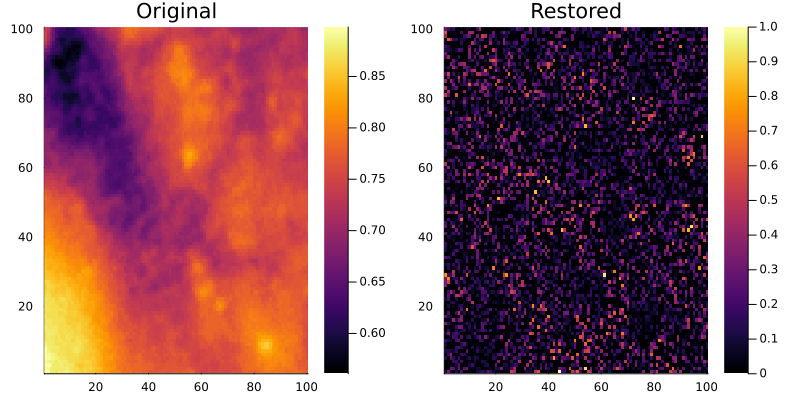

In [8]:
using Plots

restored_image_norm = (restored_image .- minimum(restored_image)) ./ (maximum(restored_image) - minimum(restored_image))

plot(
    heatmap(b, title="Original"),
    heatmap(restored_image_norm, title="Restored"),
    layout = (1, 2),
    size = (800, 400)
)

In [9]:
sigma=2
psf_array = Kernel.gaussian((sigma, sigma))
psf_array = psf_array ./ sum(psf_array)  # Normalize so PSF sums
psf = centered(psf_array)

9×9 OffsetArray(::Matrix{Float64}, -4:4, -4:4) with eltype Float64 with indices -4:4×-4:4:
 0.000763447  0.00183141  0.00342153  …  0.00342153  0.00183141  0.000763447
 0.00183141   0.00439334  0.00820783     0.00820783  0.00439334  0.00183141
 0.00342153   0.00820783  0.0153342      0.0153342   0.00820783  0.00342153
 0.0049783    0.0119423   0.0223112      0.0223112   0.0119423   0.0049783
 0.00564116   0.0135324   0.0252819      0.0252819   0.0135324   0.00564116
 0.0049783    0.0119423   0.0223112   …  0.0223112   0.0119423   0.0049783
 0.00342153   0.00820783  0.0153342      0.0153342   0.00820783  0.00342153
 0.00183141   0.00439334  0.00820783     0.00820783  0.00439334  0.00183141
 0.000763447  0.00183141  0.00342153     0.00342153  0.00183141  0.000763447

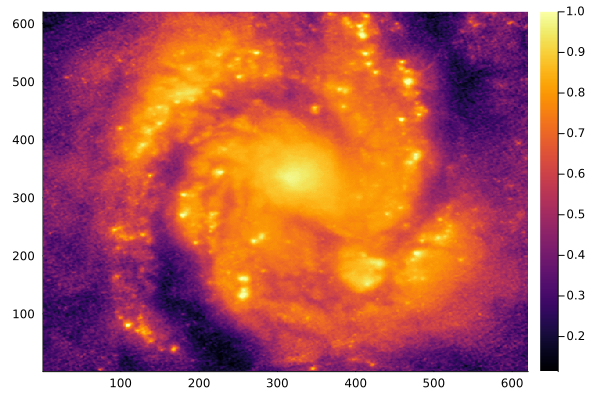

In [10]:
n=620

kx = 0
ky = 0

b = Array(gray_img[1+ky:n+ky, 1+kx:n+kx])
# img_size = size(b)
# n = img_size[1]

heatmap(b)

129800.103759765625
242499.88098144531
325735.568237304688
442957.55310058594
525186.351013183594
643287.127685546875
724732.86895751953
843579.70275878906
924351.03759765625
1043826.60217285156
1124024.60174560547
1244036.90490722656
1323723.13995361328
1444227.24609375
1523430.540466308594
1644413.99230957031
1723156.695556640625
1844587.43591308594
1922938.430786132812
2044739.24255371094
2122759.266662597656
2244866.949462890625
2322596.421813964844
2444982.41882324219
2522429.74853515625
2645090.64636230469
2722258.412170410156
2845203.533935546875
2922107.57598876953
3045308.08410644531
3121975.233459472656
3245405.21545410156
3321849.951171875
3445499.755859375
3521732.235717773438
3645594.29016113281
3721609.413146972656
3845684.28955078125
3921487.376403808594
4045774.96643066406
4121378.75213623047
4245858.648681640625
4321269.921875
4445937.13684082031
4521168.252563476562
4646012.28942871094
4721070.147705078125
4846085.22644042969
4920979.02069091797
5046155.157470703125
5

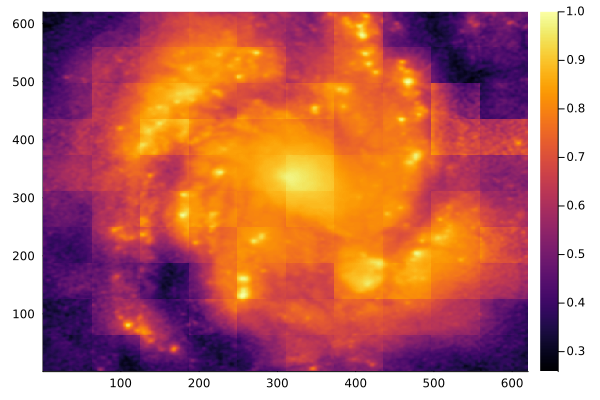

In [11]:
#testing on image with gaussian psf
using LinearAlgebra, SparseArrays

block_size = Int(n / 10)
gamma = 0.001     
max_iters = 100    
# tol = 1e-5  
tol = 0.01

# n = 100
# b = rand(n, n)       # blur image
# H = sparse(rand((n^2), (n^2)))  # PSF mat
Q = spdiagm(0 => 1 * ones(n^2))  # constraint mat (laplacian?)
x = copy(vec(b))

nblocks = size(b,1) ÷ block_size
blocks = [(i, j) for i in 1:nblocks, j in 1:nblocks]

for iter = 1:max_iters
    x_old = copy(x)
    
    for (bi, bj) in blocks
        row_range = ((bi-1)*block_size + 1):(bi*block_size)
        col_range = ((bj-1)*block_size + 1):(bj*block_size)
        block_idx = vec([(i-1)*size(b,1) + j for i in row_range, j in col_range])
        
        # Get current estimate block as 2D image
        x_block_img = reshape(x_old[block_idx], block_size, block_size)

        # Compute blurred version (Hx) and adjoint (HTHx)
        Hx_block = imfilter(x_block_img, psf, Pad(:replicate))  # blur once
        HTHx_block = imfilter(Hx_block, psf, Pad(:replicate))    # blur second time (adjoint)


        # Convert back to vector
        A_lhs = vec(HTHx_block) + gamma * (Q[block_idx, block_idx]' * Q[block_idx, block_idx]) * x_old[block_idx]

        # Right-hand side: blurred observed block passed through Hᵀ
        BMOD_i = b[row_range, col_range]
        rhs_img = imfilter(BMOD_i, psf, Pad(:replicate))
        rhs_vec = vec(rhs_img)

        denominator = clamp.(vec(HTHx_block) .+ gamma, 1e-6, Inf)
        x_block = rhs_vec ./ denominator
        # x_block = rhs_vec ./ (vec(HTHx_block) .+ gamma)

        # Clamp to [0,1]
        x_block_clamped = clamp.(x_block, 0.0, 1.0)

        # Update solution
        x[block_idx] = x_block_clamped
    end

    if norm(x - x_old) < tol
        println("Converged at iteration ", iter)
        break
    end
    println(iter, norm(x - x_old) / tol)
end

# Reshape
restored_image = reshape(x, size(b))

heatmap(restored_image')

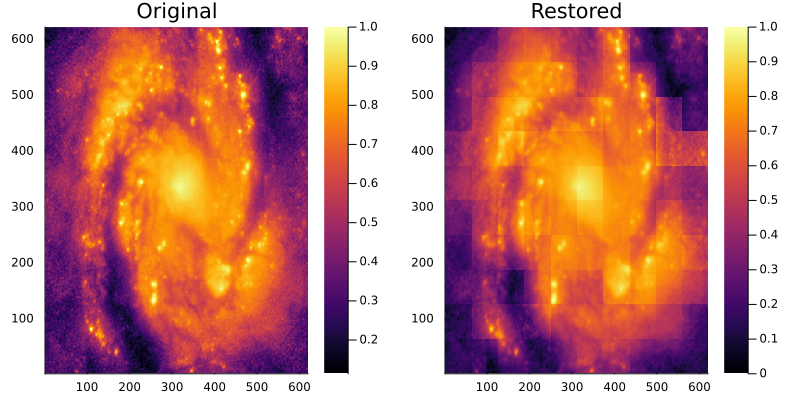

In [12]:
using Plots

restored_image_norm = (restored_image .- minimum(restored_image)) ./ (maximum(restored_image) - minimum(restored_image))

plot(
    heatmap(b, title="Original"),
    heatmap(restored_image_norm', title="Restored"),
    layout = (1, 2),
    size = (800, 400)
)

In [13]:
function apply_A(x_vec, psf, gamma, block_size)
    x_img = reshape(x_vec, block_size, block_size)
    Hx = imfilter(x_img, psf, Pad(:replicate))
    HTHx = imfilter(Hx, psf, Pad(:replicate))
    return vec(HTHx) + gamma * x_vec
end

using Pkg
Pkg.add("IterativeSolvers")
using IterativeSolvers

using Pkg
Pkg.add("KrylovKit")
using KrylovKit

# x_block = cg(
#     v -> apply_A(v, psf, gamma, block_size),  # Linear operator
#     rhs_vec,                                  # RHS vector
#     tol=1e-6, maxiter=50
# )

   Resolving package versions...
  No Changes to `~/.julia/environments/v1.11/Project.toml`
  No Changes to `~/.julia/environments/v1.11/Manifest.toml`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.11/Project.toml`
  No Changes to `~/.julia/environments/v1.11/Manifest.toml`


In [14]:
function apply_A(x_vec, psf, gamma, block_size)
    x_img = reshape(x_vec, block_size, block_size)
    Hx = imfilter(x_img, psf, Pad(:replicate))
    HTHx = imfilter(Hx, psf, Pad(:replicate))
    return vec(HTHx) + gamma * x_vec
end

using Pkg
Pkg.add("IterativeSolvers")
using IterativeSolvers

# x_block = cg(
#     v -> apply_A(v, psf, gamma, block_size),  # Linear operator
#     rhs_vec,                                  # RHS vector
#     tol=1e-6, maxiter=50
# )

   Resolving package versions...
  No Changes to `~/.julia/environments/v1.11/Project.toml`
  No Changes to `~/.julia/environments/v1.11/Manifest.toml`


In [15]:
import Pkg; Pkg.add("LinearOperators")

   Resolving package versions...
  No Changes to `~/.julia/environments/v1.11/Project.toml`
  No Changes to `~/.julia/environments/v1.11/Manifest.toml`


Iteration 1, error = 384.7118
Iteration 2, error = 0.0
Converged.


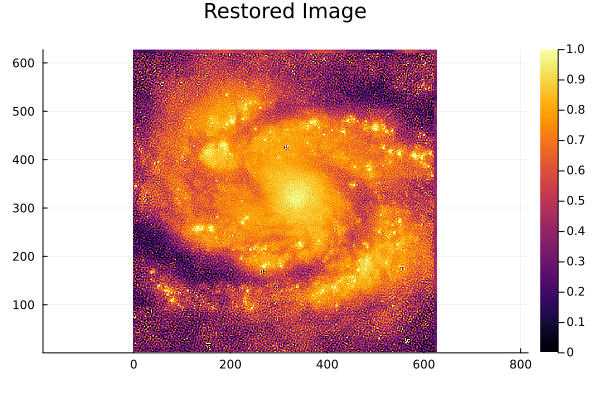

In [16]:
using Images, ImageFiltering, LinearAlgebra, SparseArrays, Plots

# --- Load or create test image ---
# img = rand(Float64, 100, 100)  # Simulated true image
# img = b

n = size(img, 1)

# --- Create PSF (Gaussian) ---
sigma = 2
psf_array = Kernel.gaussian((sigma, sigma))
psf_array = psf_array ./ sum(psf_array)  # Normalize
psf = centered(psf_array)

# --- Simulate blurred image ---
# b = imfilter(img, psf, Pad(:replicate))  # Blurred image
# b = clamp.(b, 0.0, 1.0)

b=blimp

# --- Set restoration parameters ---
block_size = 10
gamma = 1e-3
max_iters = 50
tol = 1e-2

x = copy(vec(b))  # Initial guess (flattened)
nblocks = n ÷ block_size
blocks = [(i, j) for i in 1:nblocks, j in 1:nblocks]

# --- linear operator A*x for CG ---
function apply_A(x_vec, psf, gamma, block_size)
    x_img = reshape(x_vec, block_size, block_size)
    Hx = imfilter(x_img, psf, Pad(:replicate))
    HTHx = imfilter(Hx, psf, Pad(:replicate))
    return vec(HTHx) + gamma * x_vec
end

# --- Define Linear Operator ---
mutable struct LinearOp
    psf
    gamma
    block_size
end

function (L::LinearOp)(x_vec)
    return apply_A(x_vec, L.psf, L.gamma, L.block_size)
end

# --- Conjugate Gradient (CG) ---
function cg_manual(Aop, b; maxiter=50, tol=1e-6)
    x = zeros(length(b))  # Initial guess (zero vector)
    r = b - Aop(x)       # Residual
    p = r                 # Initial search direction
    rsold = dot(r, r)     # Initial residual norm squared

    for iter in 1:maxiter
        Ap = Aop(p)          # Apply the operator to the search direction
        alpha = rsold / dot(p, Ap)  # Step size (alpha)
        x = x + alpha * p      # Update solution
        r = r - alpha * Ap     # Update residual
        rsnew = dot(r, r)      # New residual norm squared

        # Check for convergence
        if sqrt(rsnew) < tol
            println("Converged at iteration $iter")
            break
        end

        p = r + (rsnew / rsold) * p  # Update search direction
        rsold = rsnew  # Update old residual norm
    end

    return x
end

# Create Linear Operator instance
Aop = LinearOp(psf, gamma, block_size)

# --- Main Iteration (Manual CG for each block) ---
for iter = 1:max_iters
    x_old = copy(x)

    for (bi, bj) in blocks
        row_range = ((bi-1)*block_size + 1):(bi*block_size)
        col_range = ((bj-1)*block_size + 1):(bj*block_size)
        block_idx = vec([(i-1)*n + j for i in row_range, j in col_range])

        # Get blurred observation block
        BMOD_i = b[row_range, col_range]
        rhs_vec = vec(imfilter(BMOD_i, psf, Pad(:replicate)))

        # Solve with Manual Conjugate Gradient
        x_block = cg_manual(Aop, rhs_vec; maxiter=50, tol=1e-6)

        # Clamp and update
        x[block_idx] = clamp.(x_block, 0.0, 1.0)
    end

    # Convergence check
    err = norm(x - x_old)
    println("Iteration $iter, error = $err")
    if err < tol
        println("Converged.")
        break
    end
end

restored_image = reshape(x, size(b))
heatmap(restored_image, title="Restored Image", aspect_ratio=:equal)

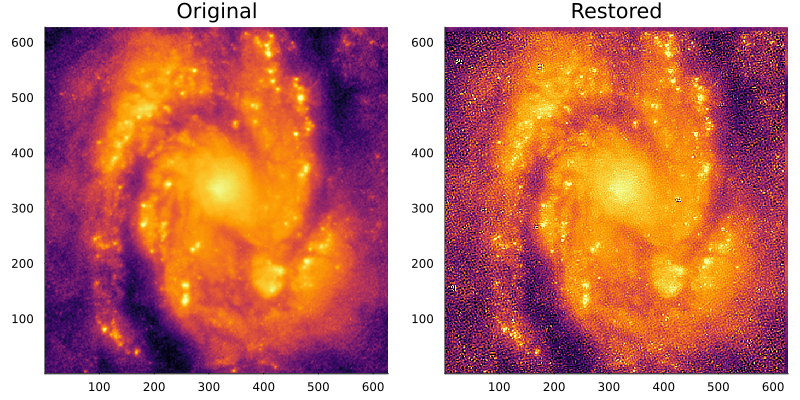

In [17]:
using Plots

restored_image_norm = (restored_image .- minimum(restored_image)) ./ (maximum(restored_image) - minimum(restored_image))

plot(
    heatmap(b, title="Original"),
    heatmap(restored_image_norm', title="Restored"),
    layout = (1, 2),
    size = (800, 400),
    colorbar = false
)

In [ ]:
using Images, ImageFiltering, LinearAlgebra, SparseArrays, Plots

# --- Load or create test image ---
img = blimp

n = size(img, 1)
b = clamp.(blimp, 0.0, 1.0)

# --- Create PSF (Gaussian) ---
sigma = 2
psf_array = Kernel.gaussian((sigma, sigma))
psf_array = psf_array ./ sum(psf_array)  # Normalize
psf = centered(psf_array)

# --- Simulate blurred image ---
# b = imfilter(img, psf, Pad(:replicate))  # Blurred image
# b = clamp.(b, 0.0, 1.0)

# --- Parameters ---
block_size = 10
gamma = 1e-3
max_iters = 20
tol = 1e+2

# --- Create second-difference matrix Q (1D first, will extend to 2D) ---
function second_difference_matrix(n)
    e = ones(n)
    Q = spdiagm(-1 => -1*e[2:end], 0 => 2*e, 1 => -1*e[1:end-1])
    Q = Q[2:end-1, :]  # Remove first and last rows
    return Q
end

Q1D = second_difference_matrix(n)
I_sparse = spdiagm(0 => ones(n))
Q2D = kron(I_sparse, Q1D) + kron(Q1D, I_sparse)

# --- Helper: linear operator A*x for CG ---
function apply_A(x_vec, psf, gamma, n, Q2D)
    x_img = reshape(x_vec, n, n)
    Hx = imfilter(x_img, psf, Pad(:replicate))
    HTHx = imfilter(Hx, psf, Pad(:replicate))
    HTHx_vec = vec(HTHx)
    return HTHx_vec + gamma * (Q2D' * (Q2D * x_vec))
end

# --- Manual CG Solver ---
function cg_manual(A, b; maxiter=100, tol=1e-6)
    x = zeros(length(b))
    r = copy(b)  # initial residual (assuming x=0)
    p = copy(r)
    rsold = dot(r, r)

    for iter = 1:maxiter
        Ap = A(p)
        alpha = rsold / (dot(p, Ap) + 1e-12)  # small epsilon to avoid div by 0
        x .= x .+ alpha .* p
        r .= r .- alpha .* Ap
        rsnew = dot(r, r)

        if sqrt(rsnew) < tol
            println("  CG converged at iteration $iter with residual norm $(sqrt(rsnew))")
            break
        end

        p .= r .+ (rsnew / rsold) .* p
        rsold = rsnew
    end

    return x
end

# --- Main Iteration Loop ---
x = vec(copy(b))  # initial guess
nblocks = n ÷ block_size
blocks = [(i, j) for i in 1:nblocks, j in 1:nblocks]

for iter = 1:max_iters
    x_old = copy(x)

    for (bi, bj) in blocks
        row_range = ((bi-1)*block_size + 1):(bi*block_size)
        col_range = ((bj-1)*block_size + 1):(bj*block_size)
        block_idx = vec([(i-1)*n + j for i in row_range, j in col_range])

        # Extract current block
        b_block = b[row_range, col_range]
        rhs_vec = vec(imfilter(b_block, psf, Pad(:replicate)))

        # Define operator A*v
        function A_block(v)
            full_vec = copy(x_old)
            full_vec[block_idx] .= v
            return apply_A(full_vec, psf, gamma, n, Q2D)[block_idx]
        end

        # Solve with manual CG
        x_block = cg_manual(A_block, rhs_vec; maxiter=50, tol=1e-6)

        # Clamp and update
        x[block_idx] = clamp.(x_block, 0.0, 1.0)
    end

    # Convergence check
    err = norm(x - x_old)
    println("Iteration $iter, error = $err")
    if err < tol
        println("Converged.")
        break
    end
end

# --- Postprocess ---
restored_image = reshape(x, size(b))
heatmap(restored_image, title="Restored Image with Second-Difference Regularization", aspect_ratio=:equal)

Iteration 1, error = 318.4245029020077


In [ ]:
using Plots

restored_image_norm = (restored_image .- minimum(restored_image)) ./ (maximum(restored_image) - minimum(restored_image))

plot(
    heatmap(b, title="Original"),
    heatmap(restored_image_norm', title="Restored"),
    layout = (1, 2),
    size = (800, 400),
    colorbar = false
)